In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import colors
import os, pdb
import pickle
import muse as muse
from muse.synthesis.synthesis import vdem_synthesis
from muse.instr.utils import create_eff_area_xarray
from muse.instr.utils import create_resp_func, create_resp_line_list, create_resp_func_ci

os.environ["XUVTOP"] = "/home/ec2-user/SageMaker/data/CHIANTI"
import ChiantiPy
import ChiantiPy.core as ch
import ChiantiPy.tools.filters as chfilters
import ChiantiPy.tools.io as chio
import matplotlib as mpl
mpl.rcParams['animation.ffmpeg_path'] = '/home/ec2-user/SageMaker/bin/ffmpeg-7.0.2-amd64-static/ffmpeg'

plt.rcParams["image.origin"] = 'lower'

Matplotlib is building the font cache; this may take a moment.


 ChiantiPy version 0.15.2 
 using cli
 using CLI for selections


/home/ec2-user/SageMaker/envs/muse_conda/lib/python3.11/site-packages/ChiantiPy/core/IpyMspectrum.py:9: UserWarning: ipyparallel not found. You won't be able to use the ipymspectrum module
  warnings.warn("ipyparallel not found. You won't be able to use the ipymspectrum module")


In [2]:
response = xr.open_zarr('/home/ec2-user/SageMaker/code/benchmark/response_function.zarr').compute()

In [3]:
wv_min = response.SG_wvl.isel(line=5).min().values
wv_max = response.SG_wvl.isel(line=5).max().values
wv_temp = response.SG_wvl.isel(line=5, slit=0).values
dlam = np.mean(wv_temp[1:] - wv_temp[:-1])
wv = np.arange(wv_min, wv_max, dlam)

In [4]:
wv_min, wv_max

(array(256.49608276), array(313.09297685))

In [5]:
temp = 10.**(5.5+0.1*np.arange(15))
dens = 1.e+9
wvlRange = [wv.min(),wv.max()]

In [42]:
if True:
    s = ch.spectrum(temp, dens, wv, abundance='sun_coronal_2021_chianti', 
                    filter = (chfilters.gaussian, dlam),
                    doContinuum=0, minAbund=1.e-5)
    s.saveData('/home/ec2-user/SageMaker/code/presentation/coronal_spectrum.pkl', verbose=False)
else:
    with open('/home/ec2-user/SageMaker/code/presentation/coronal_spectrum.pkl', 'rb') as inpt:
        s = pickle.load(inpt)

 elapsed seconds =      361.000


In [ ]:
# vdem = xr.open_zarr('/home/ec2-user/SageMaker/data/benchmark_555806/muse_vdem_m-flare-muram_los2_trac_fixedvdop_JMS_2May2025_555806.zarr').compute()
# vdem['vdem'] = xr.where(vdem.vdem < 0, 0, vdem.vdem)

# s = ch.spectrum(10**(vdem.logT.values), 1e9, wv, filter = (chfilters.gaussian, dlam), 
#                 em = vdem.vdem.sel(x=47, y=42, method='nearest').sum(dim='vdop'), 
#                 doContinuum=0, minAbund=1.e-5)

In [43]:
def gaussian(lam, wid):
    lam0 = 284.163
    return np.exp(-0.5*((lam-lam0)/wid)**2)    

In [44]:
init_wid = 10
after_filter = s.Intensity['integrated']*gaussian(s.Intensity['wvl'], init_wid)

In [45]:
import ChiantiPy.tools.util as util
loc = (after_filter > 2e-25) & \
      (s.Intensity['wvl'] > wv_min) & \
      (s.Intensity['wvl'] < wv_max)

ion_name = [util.convertName(ii) for ii in s.Intensity['ionS'][loc]]
ion_wv = s.Intensity['wvl'][loc]
ion_int = s.Intensity['integrated'][loc]

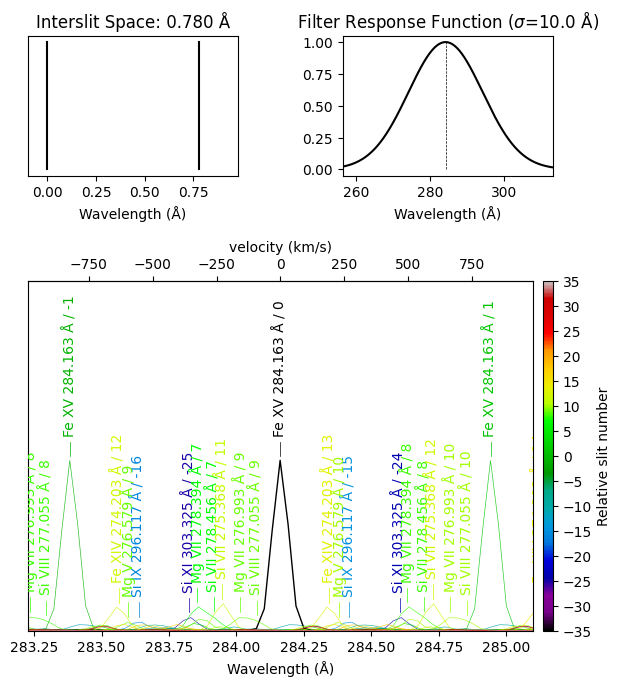

In [46]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib.animation as animation 
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.rcParams["animation.html"] = "jshtml"

aa = response.SG_wvl.isel(line=5, SG_xpixel=0).values
slit_dist_in_wv = np.abs(np.mean(aa[1:] - aa[:-1]))
orig_spec = s.Spectrum['integrated']

fig, ax = plt.subplots(figsize=[7, 7])
# ax.plot(wv, orig_spec*gaussian(wv, init_wid), color='k')
ax.set(ylim=[-1e-25, 1.2e-22], xlim=284.163+np.array([-1, 1])*slit_dist_in_wv*1.2, 
       xlabel='Wavelength (Å)', position=[0.1, 0.1, 0.75, 0.5], 
       yticks=[])
bar_len = 5e-24
bar_gap = 2e-24
color='k'
lam0 = 284.163

cmap = plt.get_cmap('nipy_spectral')
norm = mcolors.Normalize(vmin=-35, vmax=35)
sm = cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Required for colorbar in some matplotlib versions
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="2%", pad=0.1)  # size and padding
cbar = fig.colorbar(sm, ax=ax, cax=cax, ticks=np.arange(-35, 40, 5))
cbar.set_label('Relative slit number')

def forward(x): return 3e5*(x-lam0)/lam0
def inverse(x): return lam0*(1+x/3e5)
secax = ax.secondary_xaxis('top', functions=(forward, inverse))
secax.set_xlabel('velocity (km/s)')

ax0 = fig.add_subplot()
ax0.set(position=[0.1, 0.75, 0.3, 0.2], 
        xlim=[-0.1, slit_dist_in_wv+0.2], 
        yticks=[], 
        title=f'Interslit Space: {slit_dist_in_wv:.3f} Å', xlabel='Wavelength (Å)')
ax0.plot([slit_dist_in_wv]*2, [0, 1], ls='--', lw=0.5, color='k')
ax0.plot([0, 0], [0, 1], color='k')
slit_space_plot = ax0.plot([slit_dist_in_wv]*2, [0, 1], color='k')[0]

ax1 = fig.add_subplot()
ax1.set(position=[0.55, 0.75, 0.3, 0.2], 
        xlim=wv[[0, -1]], xlabel='Wavelength (Å)', 
        title=f'Filter Response Function ($\sigma$={init_wid:4.1f} Å)')
ax1.plot([lam0]*2, ax1.get_ylim(), '--', color='k', lw=0.5)
filter_response_plot = ax1.plot(wv, gaussian(wv, init_wid), color='k')[0]

spec_ = []
text_ = []
bars_ = []

for i, slit in enumerate(range(-35, 35)):
    color = 'k' if slit == 0 else cmap(norm(slit))
    spec0 = ax.plot(wv+slit_dist_in_wv*slit, 
                    orig_spec*gaussian(wv, init_wid), 
                    color=color, 
                    lw =1 if slit == 0 else 0.5, 
                    alpha=1 if slit == 0 else 0.8)
    spec_.append(spec0)
    bars00 = []
    text00 = []
    for ii, name in enumerate(ion_name):
        new_wv = ion_wv[ii]+slit_dist_in_wv*slit
        int_val = np.interp(ion_wv[ii], wv, orig_spec*gaussian(wv, init_wid))
        bars0 = ax.plot([new_wv]*2, [int_val+bar_gap, int_val+bar_gap+bar_len], 
                        color=color, lw=0.5)        
        bars00.append(bars0)
        text0 = ax.text(new_wv, int_val+bar_gap*2+bar_len, 
                        f'{ion_name[ii]["spectroscopic"]} {ion_wv[ii]:.3f} Å / {slit}', 
                        rotation=90, va='bottom', ha='center', color=color, clip_on=True, 
                        size=10)
        text00.append(text0)
    bars_.append(bars00)
    text_.append(text00)

def animate_dist(new_slit_dist_in_wv):
    for i, slit in enumerate(range(-35, 35)):
        spec_[i][0].set_data(wv+new_slit_dist_in_wv*slit, 
                             orig_spec*gaussian(wv, init_wid))
        for ii, name in enumerate(ion_name):
            new_wv = ion_wv[ii]+new_slit_dist_in_wv*slit
            bars_[i][ii][0].set_data([new_wv]*2, bars_[i][ii][0].get_ydata())
            text_[i][ii].set_position((new_wv, text_[i][ii].get_position()[1]))
    slit_space_plot.set_data([new_slit_dist_in_wv]*2, [0, 1])
    ax0.set(title=f'Interslit Space: {new_slit_dist_in_wv:.3f} Å')

up = np.arange(0, 0.1, 0.005)
mov = np.concatenate([up, up[::-1], -up, -up[::-1]])
new_slit_dist_in_wv = slit_dist_in_wv+mov
ani = animation.FuncAnimation(fig, animate_dist, frames=new_slit_dist_in_wv, interval=1e2)
ani.save('/home/ec2-user/SageMaker/code/presentation/change_slit_dist.mp4', writer='ffmpeg', fps=10)
ani


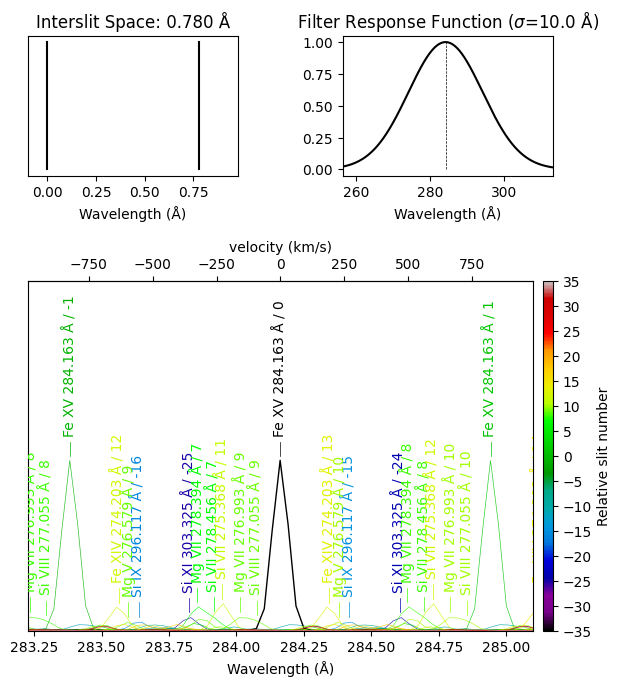

In [47]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib.animation as animation 
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.rcParams["animation.html"] = "jshtml"

aa = response.SG_wvl.isel(line=5, SG_xpixel=0).values
slit_dist_in_wv = np.abs(np.mean(aa[1:] - aa[:-1]))
orig_spec = s.Spectrum['integrated']

fig, ax = plt.subplots(figsize=[7, 7])
# ax.plot(wv, orig_spec*gaussian(wv, init_wid), color='k')
ax.set(ylim=[-1e-25, 1.2e-22], xlim=284.163+np.array([-1, 1])*slit_dist_in_wv*1.2, 
       xlabel='Wavelength (Å)', position=[0.1, 0.1, 0.75, 0.5], 
       yticks=[])
bar_len = 5e-24
bar_gap = 2e-24
color='k'
lam0 = 284.163

cmap = plt.get_cmap('nipy_spectral')
norm = mcolors.Normalize(vmin=-35, vmax=35)
sm = cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Required for colorbar in some matplotlib versions
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="2%", pad=0.1)  # size and padding
cbar = fig.colorbar(sm, ax=ax, cax=cax, ticks=np.arange(-35, 40, 5))
cbar.set_label('Relative slit number')

def forward(x): return 3e5*(x-lam0)/lam0
def inverse(x): return lam0*(1+x/3e5)
secax = ax.secondary_xaxis('top', functions=(forward, inverse))
secax.set_xlabel('velocity (km/s)')

ax0 = fig.add_subplot()
ax0.set(position=[0.1, 0.75, 0.3, 0.2], 
        xlim=[-0.1, slit_dist_in_wv+0.2], 
        yticks=[], 
        title=f'Interslit Space: {slit_dist_in_wv:.3f} Å', xlabel='Wavelength (Å)')
ax0.plot([slit_dist_in_wv]*2, [0, 1], ls='--', lw=0.5, color='k')
ax0.plot([0, 0], [0, 1], color='k')
slit_space_plot = ax0.plot([slit_dist_in_wv]*2, [0, 1], color='k')[0]

ax1 = fig.add_subplot()
ax1.set(position=[0.55, 0.75, 0.3, 0.2], 
        xlim=wv[[0, -1]], xlabel='Wavelength (Å)', 
        title=f'Filter Response Function ($\sigma$={init_wid} Å)')
ax1.plot([lam0]*2, ax1.get_ylim(), '--', color='k', lw=0.5)
filter_response_plot = ax1.plot(wv, gaussian(wv, init_wid), color='k')[0]

spec_ = []
text_ = []
bars_ = []

for i, slit in enumerate(range(-35, 35)):
    color = 'k' if slit == 0 else cmap(norm(slit))
    spec0 = ax.plot(wv+slit_dist_in_wv*slit, 
                    orig_spec*gaussian(wv, init_wid), 
                    color=color, 
                    lw =1 if slit == 0 else 0.5, 
                    alpha=1 if slit == 0 else 0.8)
    spec_.append(spec0)
    bars00 = []
    text00 = []
    for ii, name in enumerate(ion_name):
        new_wv = ion_wv[ii]+slit_dist_in_wv*slit
        int_val = np.interp(ion_wv[ii], wv, orig_spec*gaussian(wv, init_wid))
        bars0 = ax.plot([new_wv]*2, [int_val+bar_gap, int_val+bar_gap+bar_len], 
                        color=color, lw=0.5)        
        bars00.append(bars0)
        text0 = ax.text(new_wv, int_val+bar_gap*2+bar_len, 
                        f'{ion_name[ii]["spectroscopic"]} {ion_wv[ii]:.3f} Å / {slit}', 
                        rotation=90, va='bottom', ha='center', color=color, clip_on=True, 
                        size=10)
        text00.append(text0)
    bars_.append(bars00)
    text_.append(text00)

def animate_wid(new_wid):
    for i, slit in enumerate(range(-35, 35)):
        spec_[i][0].set_data(wv+slit_dist_in_wv*slit, 
                             orig_spec*gaussian(wv, new_wid))
        for ii, name in enumerate(ion_name):
            new_wv = ion_wv[ii]+slit_dist_in_wv*slit
            int_val = np.interp(ion_wv[ii], wv, orig_spec*gaussian(wv, new_wid))
            bars_[i][ii][0].set_data(bars_[i][ii][0].get_xdata(),[int_val+bar_gap, int_val+bar_gap+bar_len])
            text_[i][ii].set_position((new_wv, int_val+bar_gap*2+bar_len))
    filter_response_plot.set_data(wv, gaussian(wv, new_wid))
    ax1.set(title=f'Filter Response Function ($\sigma$={new_wid:4.1f} Å)')

new_wid = np.arange(init_wid, init_wid-5.5, -0.5)
ani = animation.FuncAnimation(fig, animate_wid, frames=new_wid, interval=1e2)
ani.save('/home/ec2-user/SageMaker/code/presentation/change_filter.mp4', writer='ffmpeg', fps=10)
ani

In [3]:
spec_gt = xr.open_zarr('/home/ec2-user/SageMaker/code/benchmark/no_mask1/spectrum_synthesis_all.zarr').compute()

In [4]:
from muse.instr import mono_diffraction
from importlib import reload
reload(muse.instr.mono_diffraction)
from muse.instr import mono_diffraction

raster283 = mono_diffraction.mono_image(spec_gt, response)

/home/ec2-user/SageMaker/SourceCode/muse/muse/instr/mono_diffraction.py:97: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  n_step = spectrum.dims.get("step", 1)
<frozen _collections_abc>:774: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
/home/ec2-user/SageMaker/SourceCode/muse/muse/instr/mono_diffraction.py:98: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  img = np.zeros((spectrum.dims["y"], r

[None,
 Text(0.5, 0, 'SG_xpixel'),
 Text(0, 0.5, 'Solar Y (arcsec)'),
 Text(0.5, 1.0, 'MUSE 284 Å Band Spectrogram')]

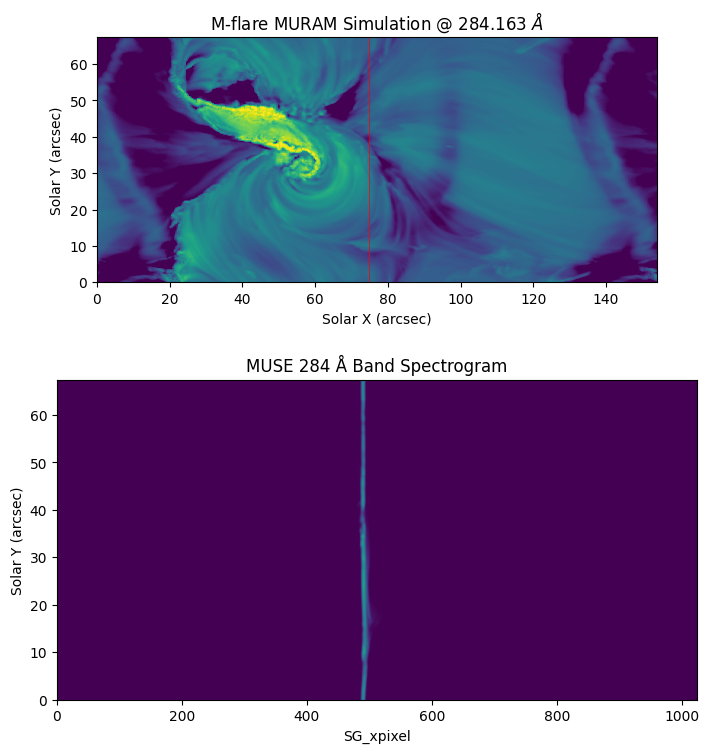

In [52]:
step = 0
slit = [17]
# slit = np.arange(35)
line = [5]
# line = [5, 6]
fig = plt.figure(figsize=[8, 8])
ax0 = fig.add_axes([0.15, 0.6, 0.7, 0.35])
ax0.imshow(raster283.isel(wave=0), norm=colors.LogNorm(1, 1e4), 
           extent=[raster283.x[0], raster283.x[-1], 
                   raster283.y[0], raster283.y[-1]])
ax0.set(aspect='equal', xlabel='Solar X (arcsec)', ylabel='Solar Y (arcsec)', 
        title=f'M-flare MURAM Simulation @ {raster283.wave[0]:.3f} $\AA$')
for s in slit:
    ax0.plot([(s*11 + step)*0.4]*2, [0, raster283.y.max()], 'r', lw=0.5)
ax1 = fig.add_axes([0.1, 0.1, 0.8, 0.4])
ax1.imshow(spec_gt.flux.isel(line=line, step=step, slit=slit).sum(dim=['slit', 'line'])+1, 
           extent=[0, 1024, 0, spec_gt.y.max()], norm=colors.LogNorm(1, 1e3))
ax1.set(aspect='auto', xlabel='SG_xpixel', ylabel='Solar Y (arcsec)', 
        title='MUSE 284 Å Band Spectrogram')

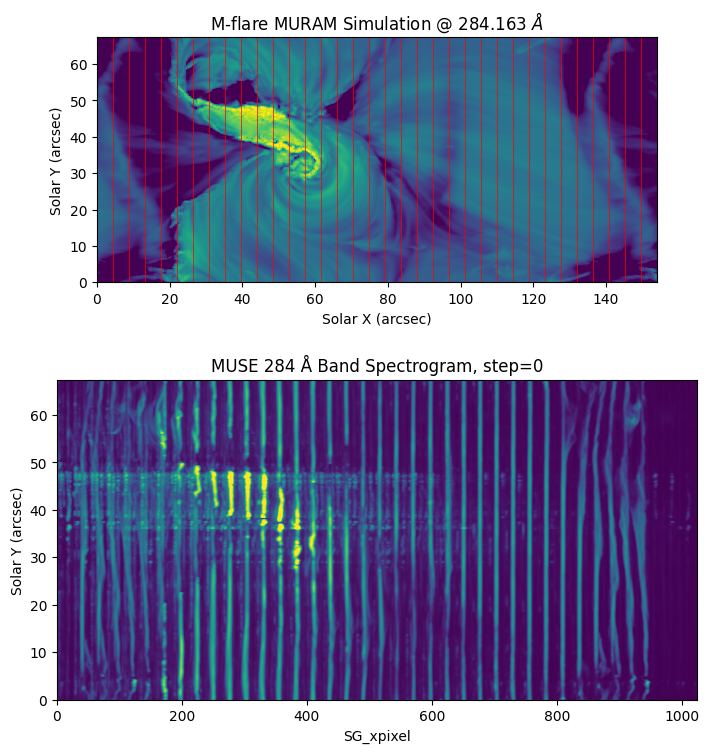

In [78]:
import matplotlib.animation as animation
import matplotlib as mpl
plt.rcParams["animation.html"] = "jshtml"

def animate(step):
    ax1.set_title(f'MUSE 284 Å Band Spectrogram, step={step}')
    for s in slit:
        p01[s].set_data([(s*11 + step)*0.4]*2, [0, raster283.y.max()],)
    im1.set_data(spec_gt.flux.isel(line=line, step=step, slit=slit).sum(dim=['slit', 'line'])+1)

step = 0
slit = np.arange(35)
line = [5, 6]
fig = plt.figure(figsize=[8, 8])
ax0 = fig.add_axes([0.15, 0.6, 0.7, 0.35])
im0 = ax0.imshow(raster283.isel(wave=0), norm=colors.LogNorm(1, 1e4), 
                   extent=[raster283.x[0], raster283.x[-1], 
                           raster283.y[0], raster283.y[-1]])
ax0.set(aspect='equal', xlabel='Solar X (arcsec)', ylabel='Solar Y (arcsec)', 
        title=f'M-flare MURAM Simulation @ {raster283.wave[0]:.3f} $\AA$')
p01 = []
for s in slit:
    p01.append(ax0.plot([(s*11 + step)*0.4]*2, [0, raster283.y.max()], 'r', lw=0.5)[0])
ax1 = fig.add_axes([0.1, 0.1, 0.8, 0.4])
im1 = ax1.imshow(spec_gt.flux.isel(line=line, step=step, slit=slit).sum(dim=['slit', 'line'])+1, 
           extent=[0, 1024, 0, spec_gt.y.max()], norm=colors.LogNorm(1, 1e3))
ax1.set(aspect='auto', xlabel='SG_xpixel', ylabel='Solar Y (arcsec)', 
        title='MUSE 284 Å Band Spectrogram')

ani = animation.FuncAnimation(fig, animate, frames=range(11), interval=5e2)
ani.save('/home/ec2-user/SageMaker/code/presentation/multi_slit_scan.mp4', writer='ffmpeg', fps=3, dpi=200)

ani

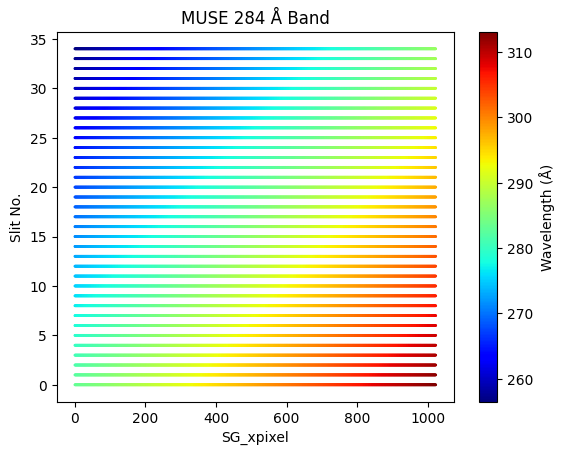

In [65]:
for s in response.slit:
    plt.scatter(np.arange(1024), [s]*1024, c=response.SG_wvl.isel(line=5, slit=s), 
                s = 1, cmap='jet', 
                vmin=response.SG_wvl.isel(line=5, slit=34)[0],
                vmax=response.SG_wvl.isel(line=5, slit=0)[-1])
plt.gca().set(xlabel='SG_xpixel', ylabel='Slit No.', title='MUSE 284 Å Band')
plt.colorbar(label='Wavelength (Å)')

In [19]:
[raster283.x[[0, -1]]]

[<xarray.DataArray 'x' (x: 2)>
 array([  0., 154.])
 Coordinates:
   * x        (x) float64 0.0 154.0]